In [1]:
import polars as pl
import plotly.express as px
import plotly.graph_objects as go
from scipy import stats
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import matplotlib.pyplot as plt
import numpy as np

import load_data_polars as dataLoader

print("\n1. Ładowanie i łączenie danych...")
players_df = dataLoader.load_players_data_pl()
league_info_df = dataLoader.load_league_info_pl()
currency_df = dataLoader.load_data_pl()

# Na później
players_full = players_df

print("Dane graczy załadowane. Wymiary:", players_df.shape)
print("Informacje o ligach załadowane. Wymiary:", league_info_df.shape)
print("Dane walut załadowane. Wymiary:", currency_df.shape)



1. Ładowanie i łączenie danych...
Dane graczy załadowane. Wymiary: (5815, 3)
Informacje o ligach załadowane. Wymiary: (11, 4)
Dane walut załadowane. Wymiary: (339611, 7)


In [2]:
# Filtracja i odrzucenie danych o ilości graczy

oldest_league_start_date = league_info_df["Release Date"].min()
newest_league_end_date = league_info_df["End Date"].max()

print(f"\nNajstarsza data startu ligi: {oldest_league_start_date}")
print(f"\nNajstarsza data startu ligi: {newest_league_end_date}")

# Filter out players data occurring before the oldest league start date
players_df_filtered = players_df.filter(
    pl.col("DateTime") >= oldest_league_start_date
)

players_df_filtered = players_df_filtered.filter(
    pl.col("DateTime") <= newest_league_end_date
)

print(
    "Dane ilości po odfiltrowaniu (data sprawdzenia >= najstarsza data startu ligi)."
    " Wymiary:",
    players_df_filtered.shape,
)
players_df = players_df_filtered


Najstarsza data startu ligi: 2021-04-16 20:00:00

Najstarsza data startu ligi: 2024-07-23 22:00:00
Dane ilości po odfiltrowaniu (data sprawdzenia >= najstarsza data startu ligi). Wymiary: (1194, 3)


In [4]:
# 1. Obliczenie odchylenia dla graczy
players_df = players_df.sort("DateTime")
players_df = players_df.with_columns(
    players_std_7d=pl.col("Players").rolling_std(window_size=7)
)

# 2. Połączenie danych walutowych z informacjami o ligach
df = currency_df.join(league_info_df, on="League", how="left")

# 3. Transformacje
df = df.with_columns([
    # Obliczenie dni od startu ligi
    (pl.col("Date") - pl.col("Release Date").dt.truncate("1d")).dt.total_days().alias("days_since_league_start"),
    # Ustandaryzowanie ceny - zakładamy, że Pay to Chaos Orb
    pl.when(pl.col("Pay") == "Chaos Orb").then(pl.col("Value")).otherwise(1 / pl.col("Value")).alias("price_in_chaos")
]).filter(pl.col("Pay") == "Chaos Orb") # Filtrujemy tylko transakcje rozliczane w Chaos Orb

# 4. Obliczenie odchylenia dla ceny (grupując po przedmiocie i lidze)
df = df.sort("Date")
df = df.with_columns(
    price_std_7d=pl.col("price_in_chaos").rolling_std(window_size=7)
)

# 5. Dołączenie danych o graczach
# Używamy asof_join, aby dołączyć najbliższy (ale nie późniejszy) pomiar graczy do danych walutowych
df = df.join_asof(players_df.select(["DateTime", "Players", "players_std_7d", "Average Players"]), left_on="Date", right_on="DateTime", strategy="backward")

# Czyszczenie i finalizacja
final_df = df.select([
    "League",
    "Date",
    "Get",
    "Confidence",
    "days_since_league_start",
    "price_in_chaos",
    "Players",
    "Average Players",
    "price_std_7d",
    "players_std_7d"
]).drop_nulls()

print("Przykładowe dane po transformacji:")
print(final_df.head())
print("\nStruktura finalnego DataFrame'a:")
final_df.glimpse()

Przykładowe dane po transformacji:
shape: (5, 10)
┌──────────┬────────────┬────────────┬───────────┬───┬─────────┬───────────┬───────────┬───────────┐
│ League   ┆ Date       ┆ Get        ┆ Confidenc ┆ … ┆ Players ┆ Average   ┆ price_std ┆ players_s │
│ ---      ┆ ---        ┆ ---        ┆ e         ┆   ┆ ---     ┆ Players   ┆ _7d       ┆ td_7d     │
│ str      ┆ datetime[μ ┆ str        ┆ ---       ┆   ┆ i64     ┆ ---       ┆ ---       ┆ ---       │
│          ┆ s]         ┆            ┆ str       ┆   ┆         ┆ f64       ┆ f64       ┆ f64       │
╞══════════╪════════════╪════════════╪═══════════╪═══╪═════════╪═══════════╪═══════════╪═══════════╡
│ Kalandra ┆ 2022-09-23 ┆ Scroll of  ┆ High      ┆ … ┆ 31877   ┆ 22558.0   ┆ 317.07170 ┆ 4469.5353 │
│          ┆ 00:00:00   ┆ Wisdom     ┆           ┆   ┆         ┆           ┆ 3         ┆ 97        │
│ Kalandra ┆ 2022-09-23 ┆ Chromatic  ┆ High      ┆ … ┆ 31877   ┆ 22558.0   ┆ 335.80420 ┆ 4469.5353 │
│          ┆ 00:00:00   ┆ Orb        ┆   

In [5]:
print("\nStatystyki opisowe dla zmiennych numerycznych:")
print(final_df.describe())


Statystyki opisowe dla zmiennych numerycznych:
shape: (9, 11)
┌───────────┬───────────┬───────────┬───────────┬───┬───────────┬───────────┬───────────┬──────────┐
│ statistic ┆ League    ┆ Date      ┆ Get       ┆ … ┆ Players   ┆ Average   ┆ price_std ┆ players_ │
│ ---       ┆ ---       ┆ ---       ┆ ---       ┆   ┆ ---       ┆ Players   ┆ _7d       ┆ std_7d   │
│ str       ┆ str       ┆ str       ┆ str       ┆   ┆ f64       ┆ ---       ┆ ---       ┆ ---      │
│           ┆           ┆           ┆           ┆   ┆           ┆ f64       ┆ f64       ┆ f64      │
╞═══════════╪═══════════╪═══════════╪═══════════╪═══╪═══════════╪═══════════╪═══════════╪══════════╡
│ count     ┆ 121946    ┆ 121946    ┆ 121946    ┆ … ┆ 121946.0  ┆ 121946.0  ┆ 121946.0  ┆ 121946.0 │
│ null_coun ┆ 0         ┆ 0         ┆ 0         ┆ … ┆ 0.0       ┆ 0.0       ┆ 0.0       ┆ 0.0      │
│ t         ┆           ┆           ┆           ┆   ┆           ┆           ┆           ┆          │
│ mean      ┆ null      ┆ 20

In [6]:
# Histogramy

for col in final_df.select(pl.col(pl.NUMERIC_DTYPES)).columns:
    fig = px.histogram(final_df, x=col, title=f'Rozkład zmiennej: {col}', marginal="box")
    fig.show()

C:\Users\Jan\AppData\Local\Temp\ipykernel_19240\3249405549.py:3: DeprecationWarning: `NUMERIC_DTYPES` was deprecated in version 1.0.0. Define your own data type groups or use the `polars.selectors` module for selecting columns of a certain data type.
  for col in final_df.select(pl.col(pl.NUMERIC_DTYPES)).columns:


In [7]:
# Macierz korelacji
numeric_cols = final_df.select(pl.col(pl.NUMERIC_DTYPES)).columns
correlation_matrix = final_df.select(numeric_cols).corr()

fig_heatmap = go.Figure(data=go.Heatmap(
    z=correlation_matrix.to_numpy(),
    x=numeric_cols,
    y=numeric_cols,
    colorscale='Viridis',
    zmin=-1,
    zmax=1
))
fig_heatmap.update_layout(title='Macierz korelacji zmiennych numerycznych')
fig_heatmap.show()

# Wykres rozrzutu: Cena vs Dni od startu ligi
fig_scatter = px.scatter(
    final_df.filter(pl.col("Get") == "Fracturing Orb"), # Filtrujemy dla jednego przedmiotu dla przejrzystości
    x="days_since_league_start",
    y="price_in_chaos",
    color="League",
    title="Cena Fracturing Orb w zależności od dnia ligi",
    trendline="ols" # Linia trendu
)
fig_scatter.show()

C:\Users\Jan\AppData\Local\Temp\ipykernel_19240\426163336.py:2: DeprecationWarning:

`NUMERIC_DTYPES` was deprecated in version 1.0.0. Define your own data type groups or use the `polars.selectors` module for selecting columns of a certain data type.



In [8]:
# Testy statystyczne

# Przygotowanie danych do testu
divine_df = final_df.filter(pl.col("Get") == "Fracturing Orb")
leagues = divine_df["League"].unique().to_list()
price_by_league = [divine_df.filter(pl.col("League") == league)["price_in_chaos"].to_numpy() for league in leagues]

# Wykonanie testu Kruskala-Wallisa
statistic, p_value = stats.kruskal(*price_by_league)

print(f"\n--- Test Statystyczny: Kruskal-Wallis ---")
print(f"Test porównuje medianę ceny 'Fracturing Orb' pomiędzy ligami: {leagues}")
print(f"Statystyka testowa: {statistic:.4f}")
print(f"P-wartość (p-value): {p_value:.4f}")

# Interpretacja wyniku
alpha = 0.05
if p_value < alpha:
    print(f"\nDecyzja: Odrzucamy hipotezę zerową (p < {alpha}).")
    print("Wniosek: Istnieją statystycznie istotne różnice w medianie ceny 'Fracturing Orb' pomiędzy co najmniej dwiema ligami.")
else:
    print(f"\nDecyzja: Nie ma podstaw do odrzucenia hipotezy zerowej (p >= {alpha}).")
    print("Wniosek: Nie znaleziono statystycznie istotnych różnic w medianie ceny 'Fracturing Orb' pomiędzy ligami.")


--- Test Statystyczny: Kruskal-Wallis ---
Test porównuje medianę ceny 'Fracturing Orb' pomiędzy ligami: ['Ancestor', 'Crucible', 'Sanctum', 'Necropolis', 'Affliction']
Statystyka testowa: 397.4909
P-wartość (p-value): 0.0000

Decyzja: Odrzucamy hipotezę zerową (p < 0.05).
Wniosek: Istnieją statystycznie istotne różnice w medianie ceny 'Fracturing Orb' pomiędzy co najmniej dwiema ligami.


In [9]:
# Redukcja wymiarowości

# 1. Przygotowanie danych (selekcja i skalowanie)
numeric_data = final_df.select(numeric_cols)
scaler = StandardScaler()
scaled_data = scaler.fit_transform(numeric_data.to_numpy())

# 2. Przeprowadzenie PCA
pca = PCA()
principal_components = pca.fit_transform(scaled_data)

# 3. Analiza wyjaśnionej wariancji
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance_ratio)

fig_variance = go.Figure()
fig_variance.add_trace(go.Bar(x=list(range(1, len(explained_variance_ratio) + 1)), y=explained_variance_ratio, name='Wyjaśniona wariancja'))
fig_variance.add_trace(go.Scatter(x=list(range(1, len(explained_variance_ratio) + 1)), y=cumulative_variance, name='Suma kumulacyjna', line=dict(color='red')))
fig_variance.update_layout(
    title='Wyjaśniona wariancja przez główne składowe',
    xaxis_title='Główna składowa',
    yaxis_title='Proporcja wariancji'
)
fig_variance.show()

# 4. Wybór liczby komponentów
# Zazwyczaj wybiera się liczbę komponentów, która wyjaśnia > 80-95% wariancji.
# Z wykresu wynika, że już 2-3 pierwsze komponenty wyjaśniają znaczną większość wariancji.

# 5. Wizualizacja 2D
pca_2d = PCA(n_components=2)
principal_components_2d = pca_2d.fit_transform(scaled_data)
pca_df = pl.DataFrame({
    'PC1': principal_components_2d[:, 0],
    'PC2': principal_components_2d[:, 1],
    'League': final_df['League'],
    'Get': final_df['Get']
})

fig_pca = px.scatter(
    pca_df,
    x='PC1',
    y='PC2',
    color='League',
    hover_data=['Get'],
    title='Wizualizacja danych po redukcji PCA (2 komponenty)'
)
fig_pca.show()

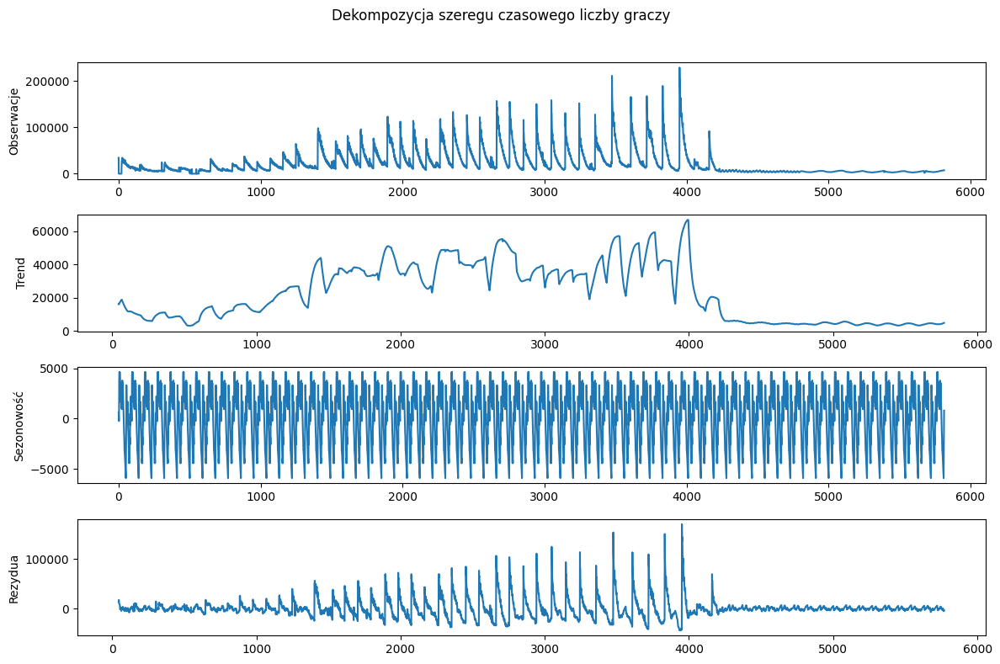


--- Test stacjonarności (ADF) dla liczby graczy ---
Statystyka ADF: -5.1550628563439185
p-wartość: 1.0852410236634333e-05
Wartości krytyczne:
	1%: -3.434260059584829
	5%: -2.863267069870164
	10%: -2.5676894489641344

Wynik: Szereg jest prawdopodobnie stacjonarny (można odrzucić H0).


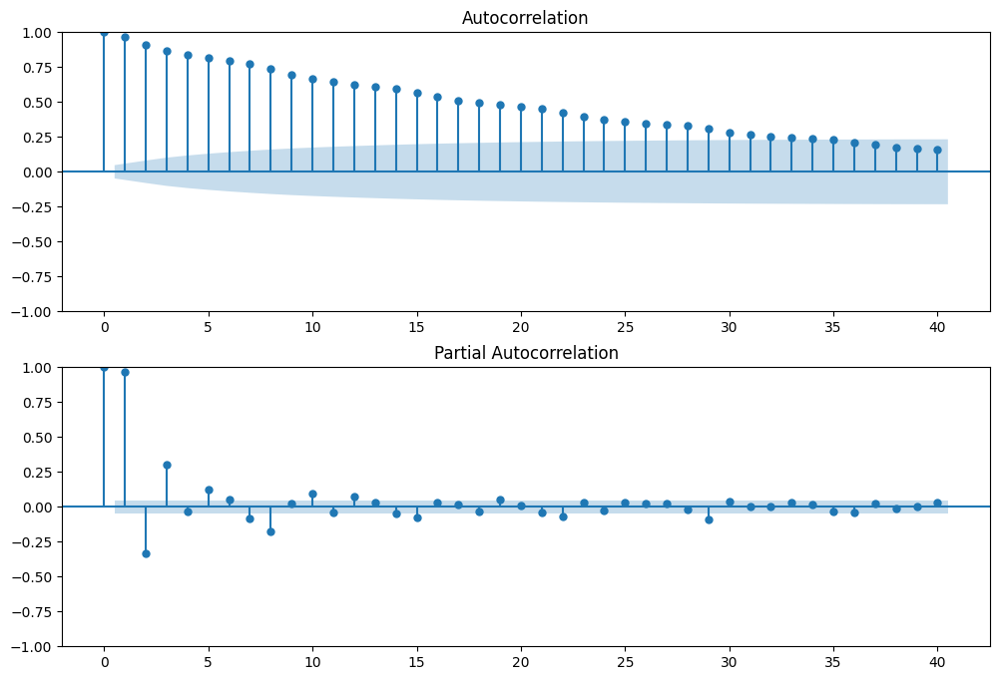

In [4]:
# Analiza szeregów czasowych

# Przygotowanie danych graczy - resamplujemy do średniej dziennej dla uproszczenia
players_daily_df = players_full.with_columns(
    pl.col("Players").fill_null(0)
)
# 1. Wizualizacja szeregu
fig_ts = px.line(players_daily_df, x='DateTime', y='Players', title='Średnia dzienna liczba graczy w czasie')
fig_ts.show()

# 2. Dekompozycja na trend, sezonowość i rezydua
# Ustawiamy okres sezonowości na 90 dni (ok. 3 miesiące, czyli typowa długość ligi)
decomposition = seasonal_decompose(players_daily_df['Players'], model='additive', period=90)

fig_decompose = plt.figure(figsize=(12, 8))
fig_decompose.suptitle('Dekompozycja szeregu czasowego liczby graczy')
ax1 = fig_decompose.add_subplot(411)
ax1.plot(decomposition.observed)
ax1.set_ylabel('Obserwacje')
ax2 = fig_decompose.add_subplot(412)
ax2.plot(decomposition.trend)
ax2.set_ylabel('Trend')
ax3 = fig_decompose.add_subplot(413)
ax3.plot(decomposition.seasonal)
ax3.set_ylabel('Sezonowość')
ax4 = fig_decompose.add_subplot(414)
ax4.plot(decomposition.resid)
ax4.set_ylabel('Rezydua')
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# 3. Test stacjonarności (Augmented Dickey-Fuller)
# H0: Szereg jest niestacjonarny (ma pierwiastek jednostkowy)
adf_result = adfuller(players_daily_df['Average Players'].drop_nulls())
print("\n--- Test stacjonarności (ADF) dla liczby graczy ---")
print(f'Statystyka ADF: {adf_result[0]}')
print(f'p-wartość: {adf_result[1]}')
print('Wartości krytyczne:')
for key, value in adf_result[4].items():
    print(f'\t{key}: {value}')

if adf_result[1] > 0.05:
    print("\nWynik: Szereg jest prawdopodobnie niestacjonarny (nie można odrzucić H0).")
else:
    print("\nWynik: Szereg jest prawdopodobnie stacjonarny (można odrzucić H0).")
    
# 4. Wykresy autokorelacji (ACF i PACF)
fig_acf_pacf, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 8))
plot_acf(players_daily_df['Average Players'].drop_nulls(), ax=ax1, lags=40)
plot_pacf(players_daily_df['Average Players'].drop_nulls(), ax=ax2, lags=40)
plt.show()

# Podsumowanie analizy

Wynik testu ADF jednoznacznie wskazuje, że liczba aktywnych graczy Path of Exile jako szereg danych jest stacjonarny i ma tendencję do powracania do swojej długoterminowej średniej.

Cykle retencji graczy powiązane z nowymi ligami choć posiadają wyraźnie zmiany w wartościach
są regularne i przewidywalne a sam szereg nie dryfuje w jednym kierunku.